In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline


In [2]:
import os
import cv2
from tqdm import tqdm
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from skimage.io import imread
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from skimage.measure import label, regionprops
import skimage.util._montage as montage
from fastai.vision import *
from fastai.callbacks.hooks import *
from fastai.utils.mem import *
import skimage
import warnings
import scipy
import shutil

warnings.filterwarnings("ignore")

In [3]:
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

In [4]:
gpu_mem_get_free_no_cache()



23818

In [5]:
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

In [6]:
path = untar_data('data/Smoke_segmentation/seg_data')
mask_train_path= path/'train_masks/train'
train_path = path/'train_images/train'
test_images = path/'test'

In [7]:
# From: https://forums.fast.ai/t/cant-do-segmentation-cuda-error-device-side-assert-triggered/37507/5?u=andandandand
class SegLabelListCustom(SegmentationLabelList):
    def open(self, fn): return open_mask(fn, div=True)

class SegItemListCustom(SegmentationItemList):
    _label_cls = SegLabelListCustom

In [8]:
fnames = get_image_files(train_path)
mask_names = get_image_files(mask_train_path)
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

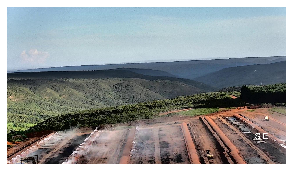

In [9]:
img_f = fnames[5]
img = open_image(img_f)
img.show(figsize=(5,5))

In [10]:
get_y_fn = lambda x :mask_train_path / str(x.stem+'.png') # Fixed


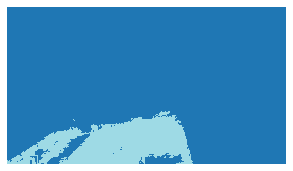

In [11]:
mask = open_mask(get_y_fn(img_f))
mask.show(figsize=(5,5), alpha=1)

In [12]:
src_size = np.array(mask.shape[1:])
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

In [13]:
src_size = np.array(mask.shape[1:])
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

In [14]:
codes =['No-Smoke', 'smoke']

In [15]:
size = [256,256]
#size =224
print(size)

[256, 256]


In [16]:
bs = 64

In [17]:
gpu_mem_get_all()

[GPUMemory(total=24219, free=23818, used=400)]

In [18]:
free = gpu_mem_get_free_no_cache()
data = (SegItemListCustom.from_folder(train_path)
        .split_by_rand_pct()
        .label_from_func(get_y_fn, classes=codes)
        .transform(get_transforms(), tfm_y=True, size=size)
        .databunch(bs=bs).normalize(imagenet_stats))

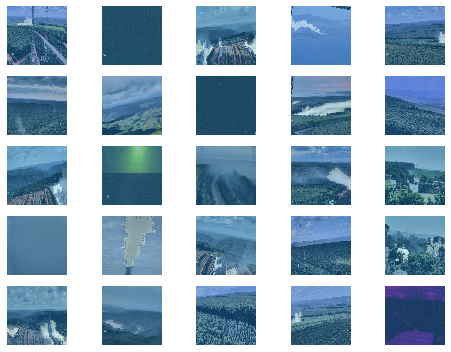

In [19]:
data.show_batch(rows=5, figsize=(7,5))


In [20]:
def dice_(input:Tensor, targs:Tensor, iou:bool=True, eps:float=1e-8)->Rank0Tensor:
    n = targs.shape[0]
    dice_sum = torch.as_tensor([0.], dtype=torch.float32, device=targs.device)
    for i in range(1, targs.max()+1):
        input_flatten = input[:,i-1,:,:].flatten(1,-1).float()
        targs_flatten = targs.flatten(1,-1).float()
        input_flatten[input_flatten>0.5], input_flatten[input_flatten<=0.5] = 1., 0.
        targs_flatten[targs_flatten!=i], targs_flatten[targs_flatten==i] = 0, 1
        intersect = (input_flatten * targs_flatten).sum(dim=1)
        union = (input_flatten + targs_flatten).sum(dim=1)
        if not iou: l = 2. * intersect / union
        else: l = intersect / (union-intersect+eps)
        l[union == 0.] = 1
        dice_sum += l.mean()
    return dice_sum / targs.max()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 4.47E-09
Min loss divided by 10: 1.17E-07


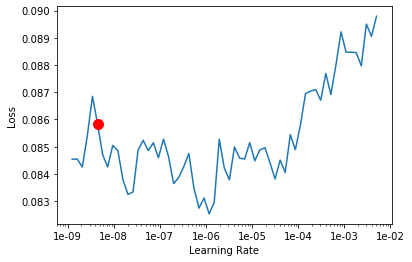

In [23]:
learn = unet_learner(data, models.resnet34, metrics=[dice], wd=1e-2)


learn.load('stage-1_res34_512')
lr_find(learn,start_lr=1e-10, end_lr=10, num_it=100, stop_div=True, wd=1e-2)
learn.recorder.plot(suggestion=True)


In [24]:

learn.fit_one_cycle(5, slice(3e-8))

epoch,train_loss,valid_loss,dice,time
0,0.085753,0.080072,0.646306,02:01
1,0.085713,0.079834,0.647278,02:00
2,0.085415,0.079847,0.646656,02:00
3,0.086876,0.079933,0.646348,02:01
4,0.085441,0.080123,0.646941,02:00


In [25]:
learn.fit_one_cycle(5, slice(2e-7))

epoch,train_loss,valid_loss,dice,time
0,0.085981,0.080004,0.647481,02:01
1,0.086343,0.079924,0.646897,02:00
2,0.085577,0.079920,0.648804,02:00
3,0.086229,0.079940,0.646482,02:01
4,0.086768,0.079661,0.647552,02:00


In [26]:
learn.save('stage-1_res34_256')

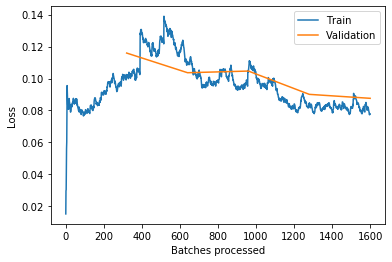

In [26]:
learn.recorder.plot_losses()

In [24]:
gpu_mem_get_all()

[GPUMemory(total=24219, free=7916, used=16302)]

In [28]:
#learn = unet_learner(data, models.resnet34, metrics=[dice_], wd=1e-2)
#learn.load('stage-1_res34_512')

learn.unfreeze()
lr_find(learn,start_lr=1e-10, end_lr=10, num_it=100, stop_div=True, wd=1e-1)


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.47E-09
Min loss divided by 10: 1.45E-05


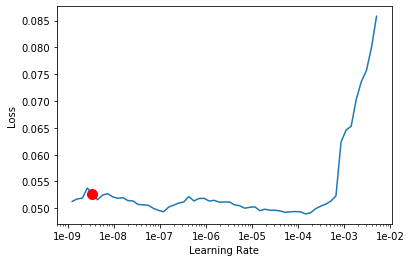

In [28]:
learn.recorder.plot(suggestion=True)


In [29]:

learn.fit_one_cycle(5, slice(3e-8,1.45e-05))

epoch,train_loss,valid_loss,dice_,time
0,0.074962,0.088061,0.012434,06:46
1,0.078559,0.087427,0.013317,06:46
2,0.073033,0.087685,0.013656,06:40
3,0.075145,0.087545,0.012523,06:37
4,0.078476,0.087393,0.013338,06:47


In [30]:
learn.save('stage-2_res34_512')

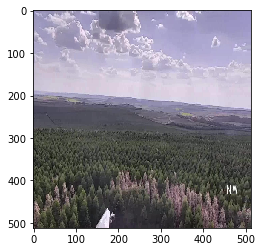

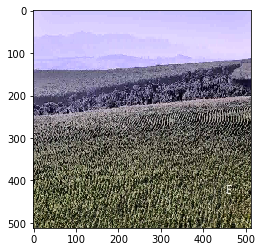

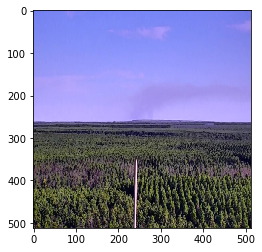

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


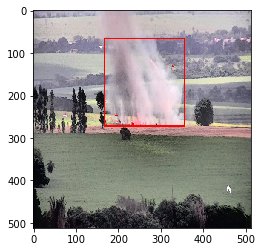

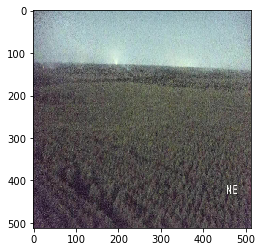

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


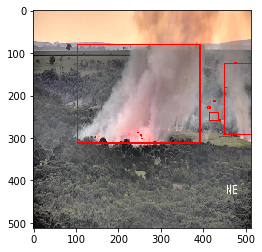

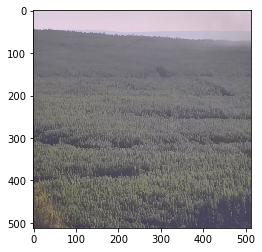

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


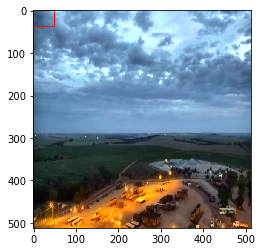

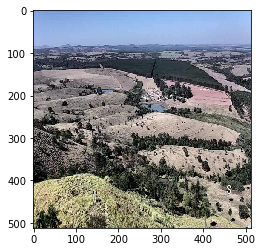

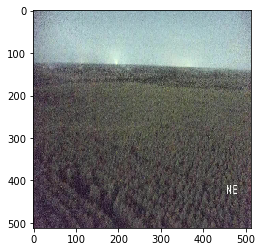

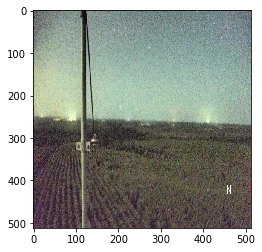

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


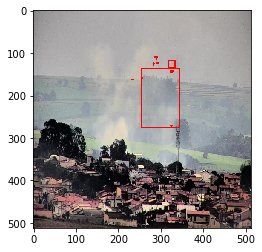

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


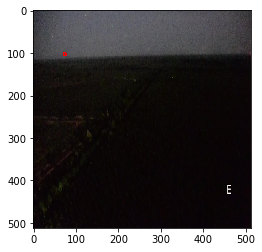

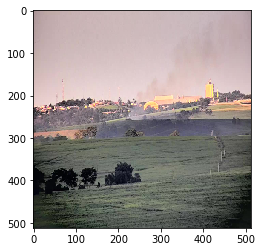

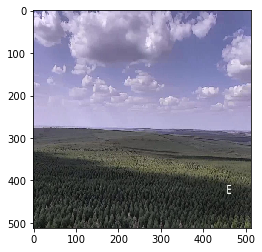

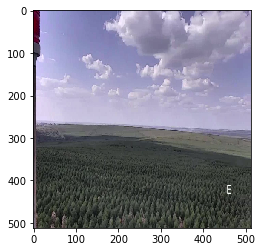

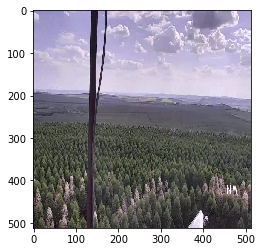

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


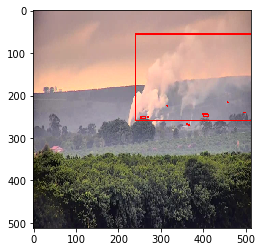

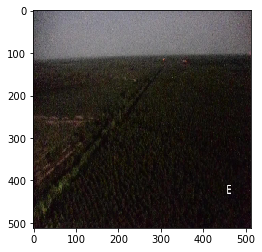

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


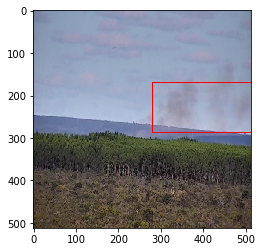

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


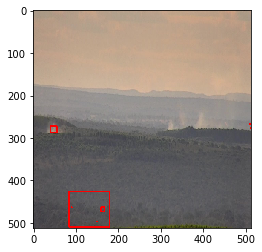

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


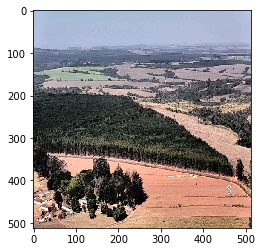

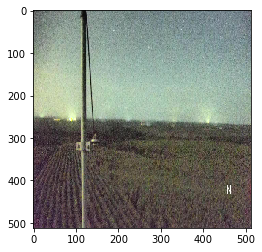

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


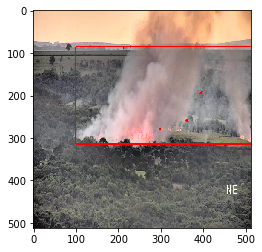

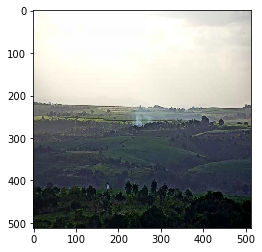

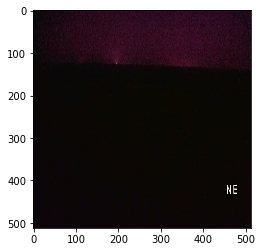

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


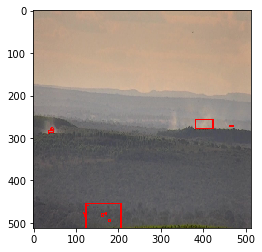

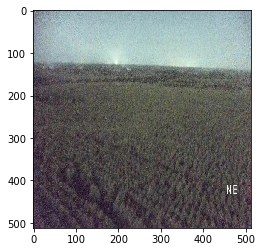

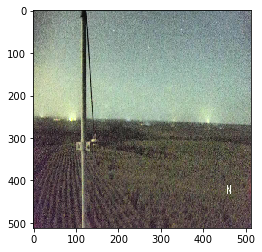

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


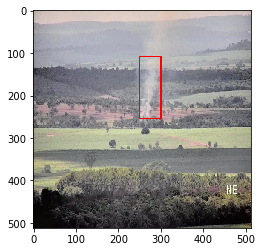

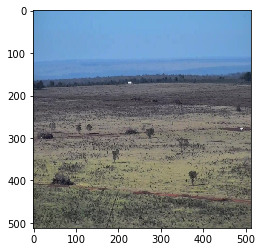

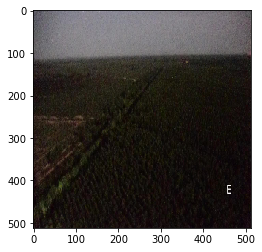

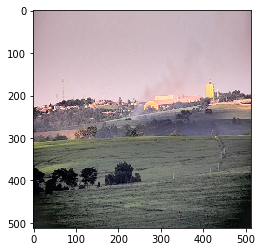

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


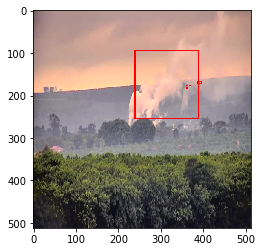

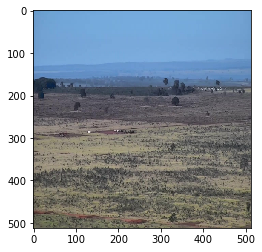

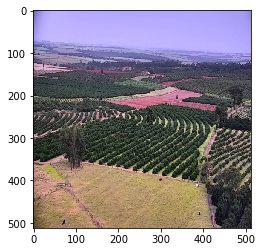

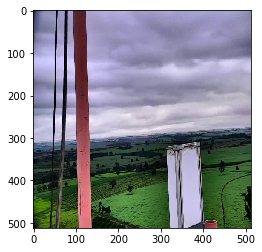

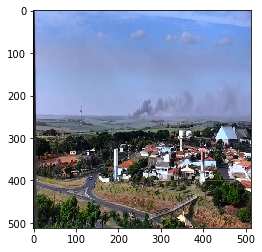

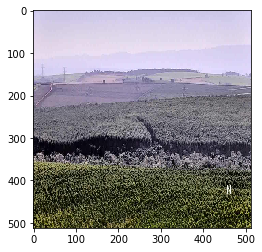

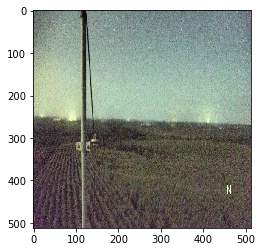

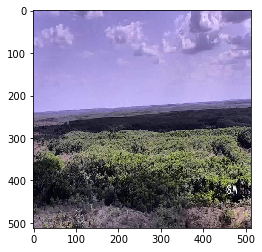

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


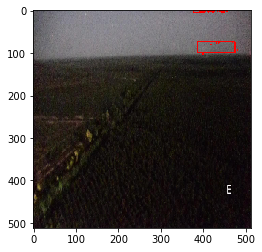

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


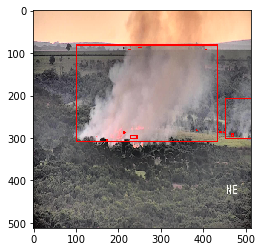

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


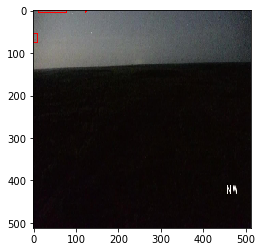

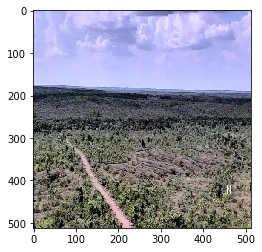

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


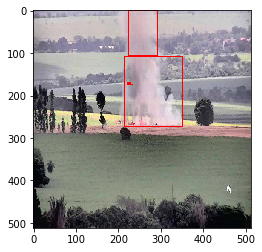

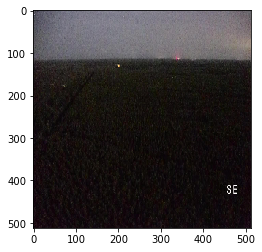

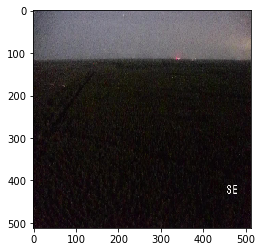

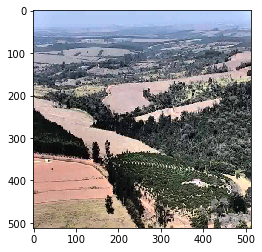

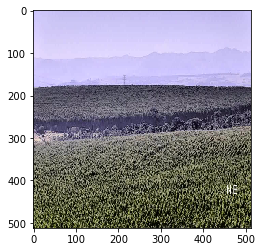

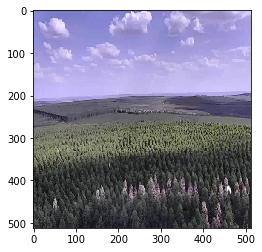

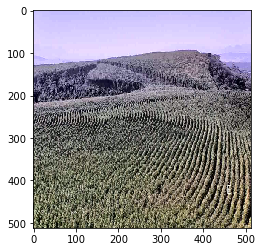

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


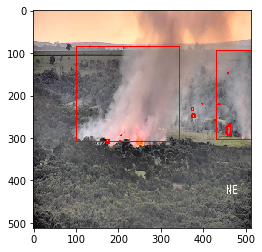

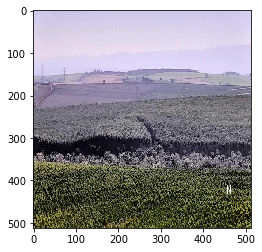

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


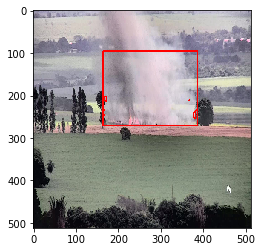

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


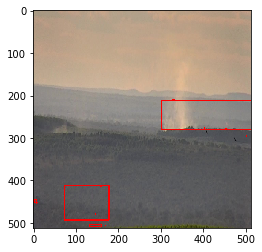

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


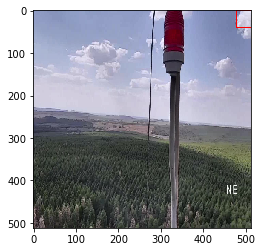

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


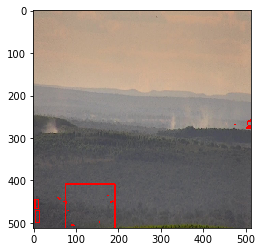

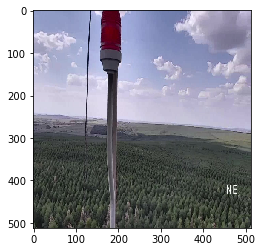

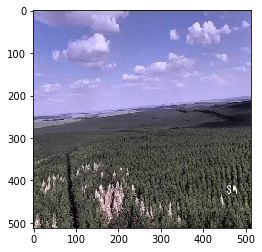

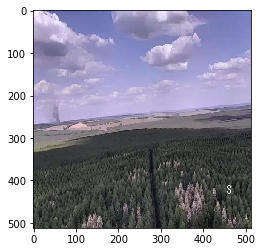

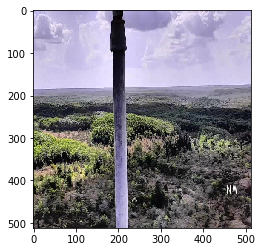

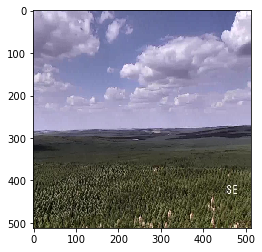

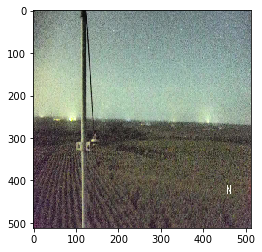

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


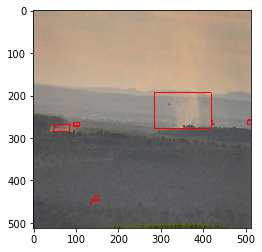

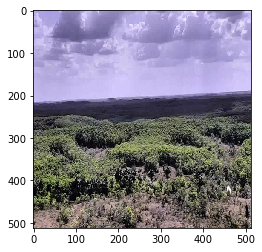

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


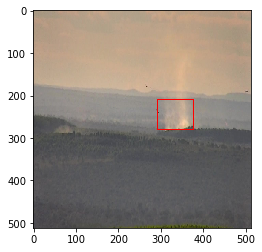

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


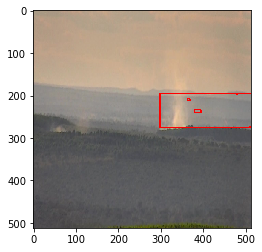

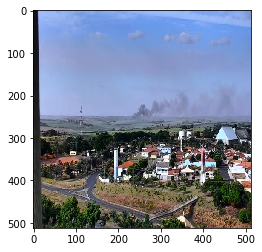

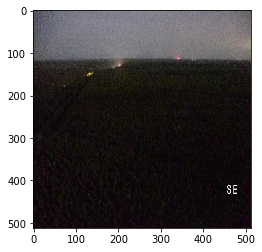

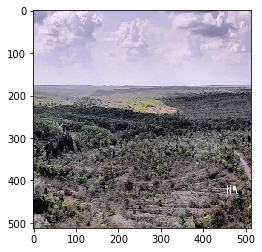

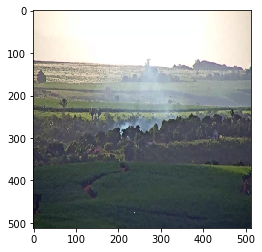

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


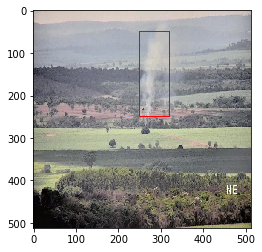

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


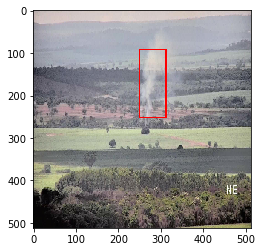

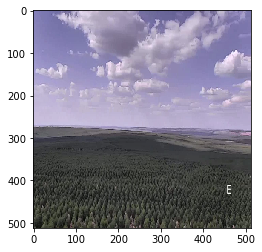

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


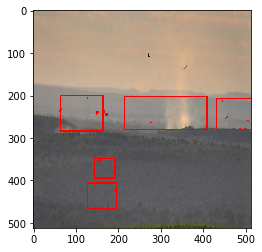

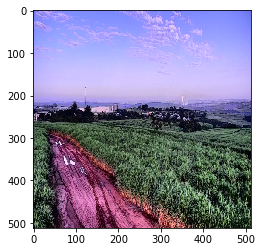

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


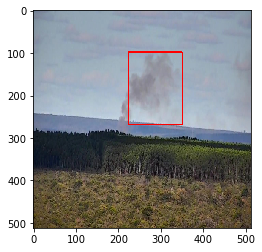

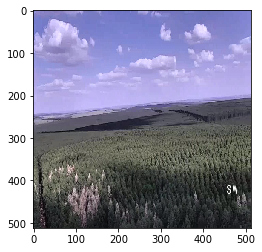

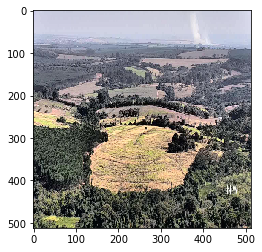

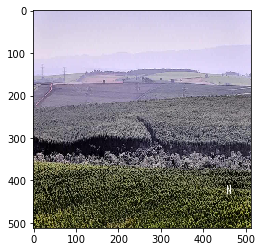

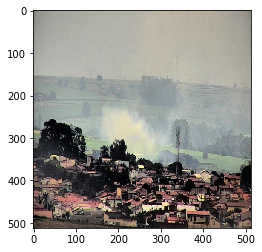

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


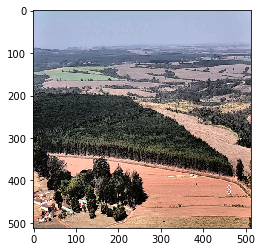

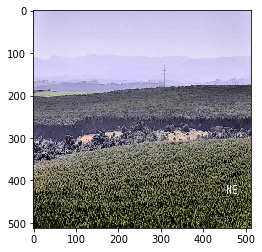

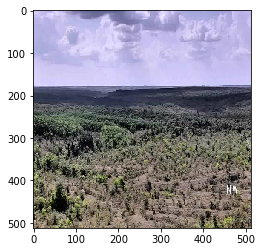

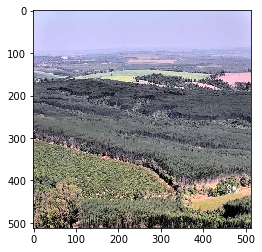

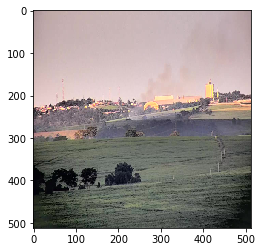

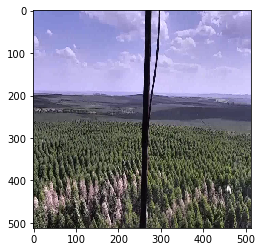

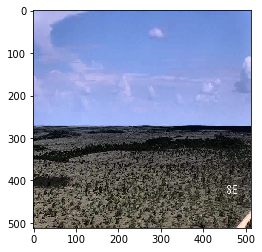

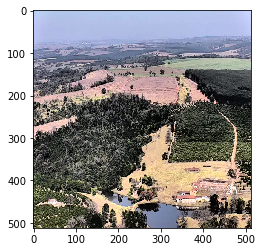

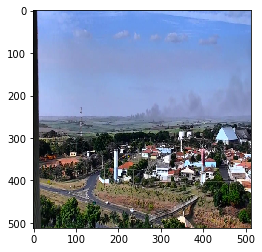

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


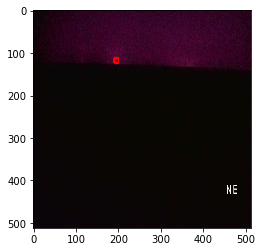

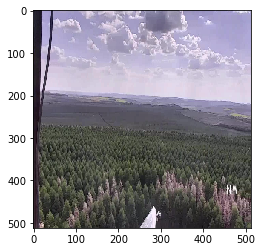

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


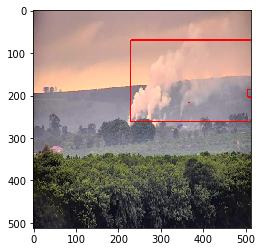

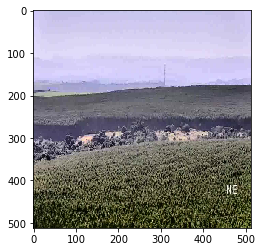

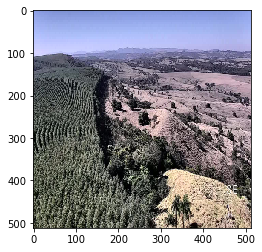

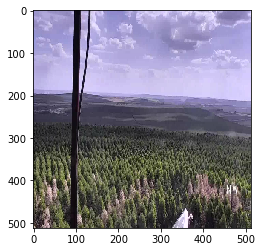

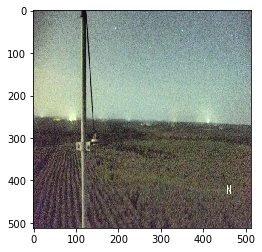

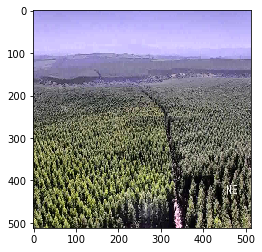

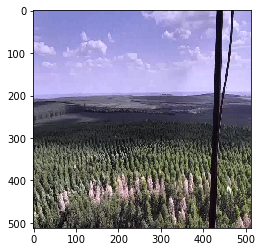

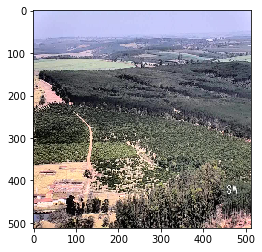

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


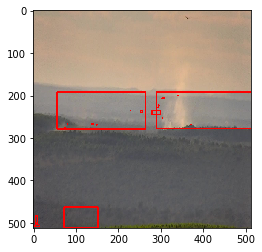

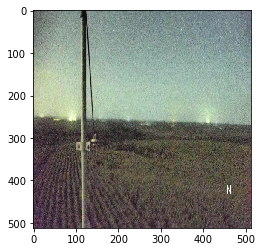

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


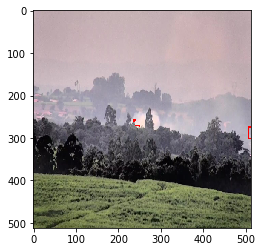

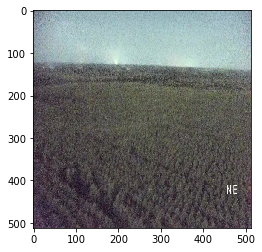

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


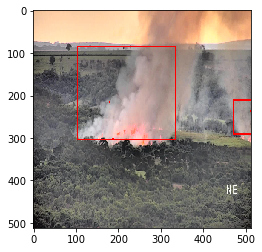

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


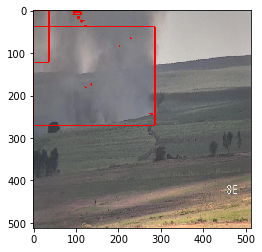

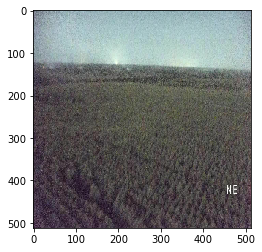

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


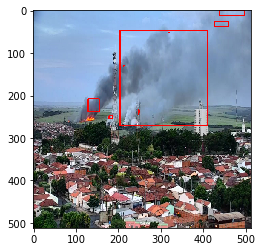

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


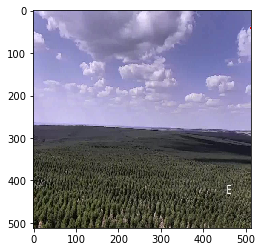

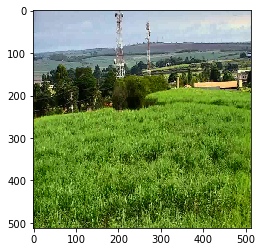

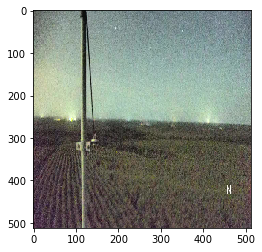

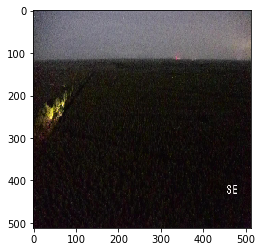

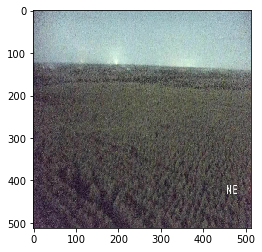

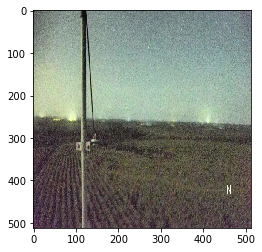

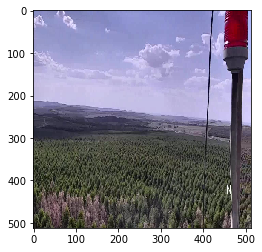

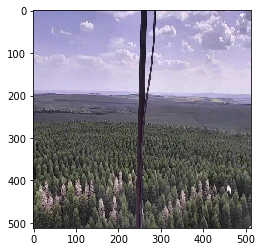

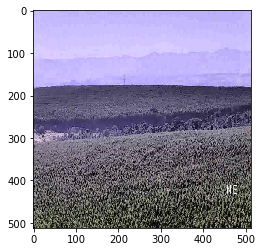

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


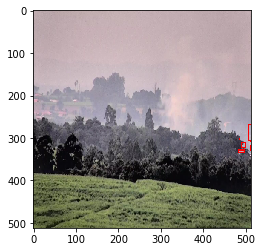

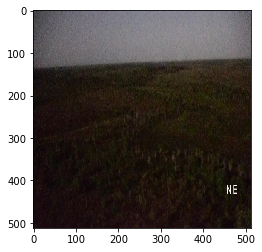

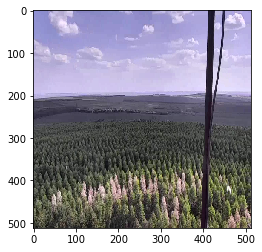

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


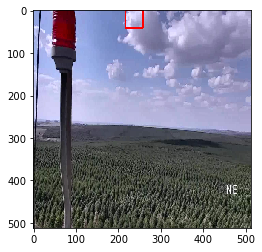

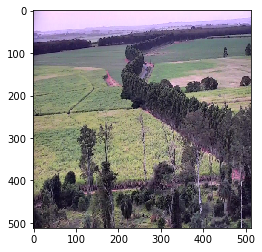

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


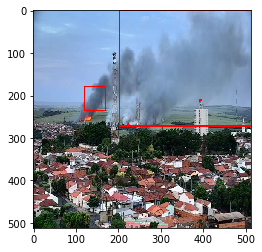

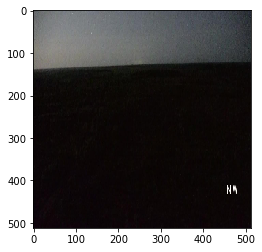

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


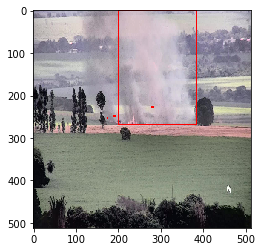

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


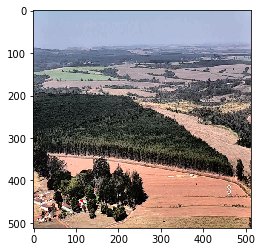

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


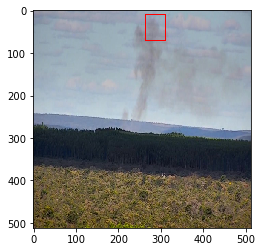

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


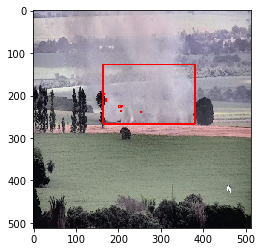

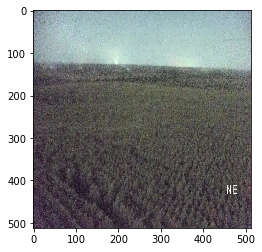

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


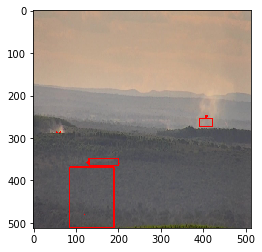

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


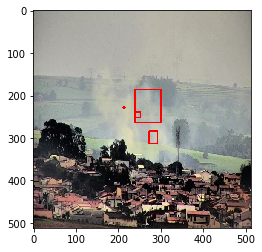

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


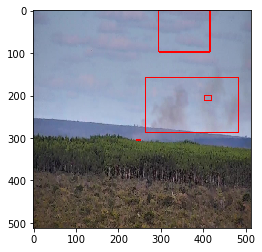

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


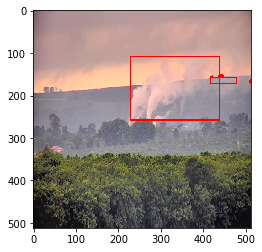

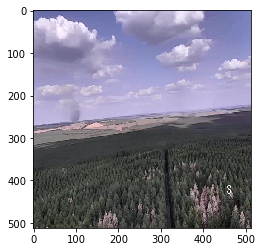

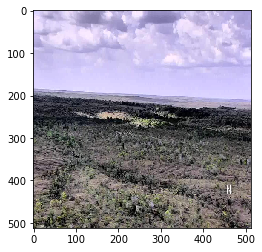

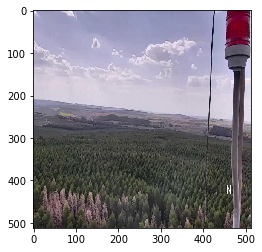

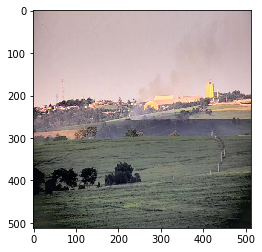

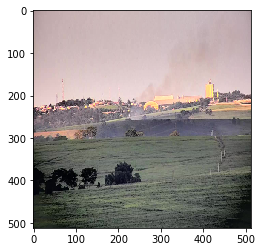

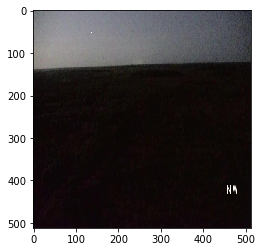

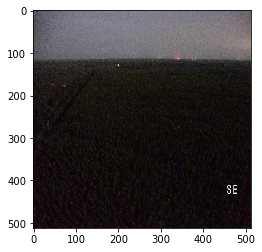

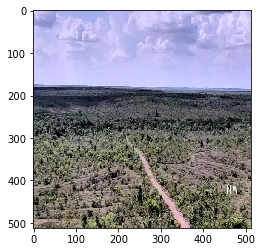

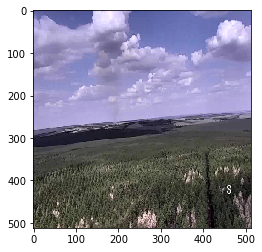

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


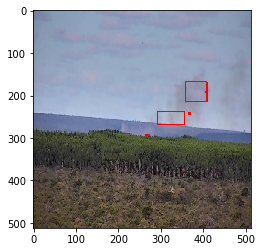

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


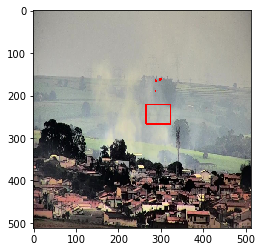

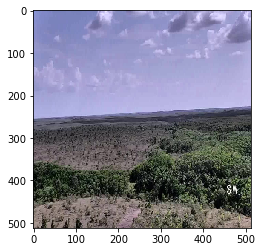

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


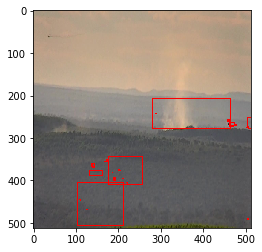

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


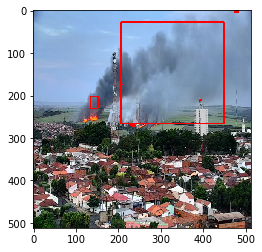

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


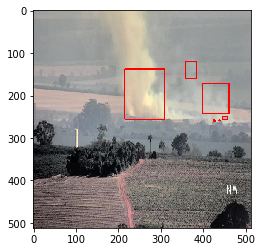

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


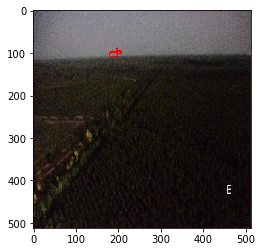

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


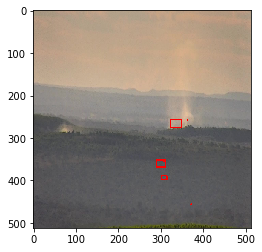

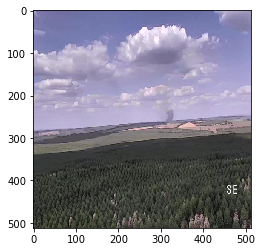

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


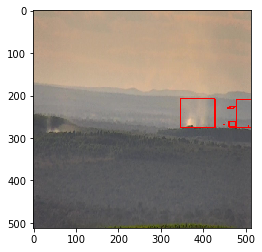

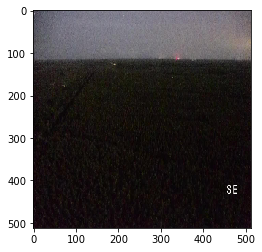

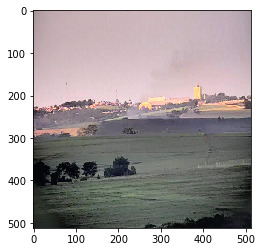

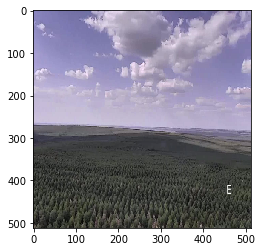

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


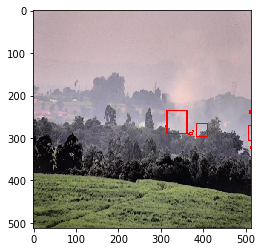

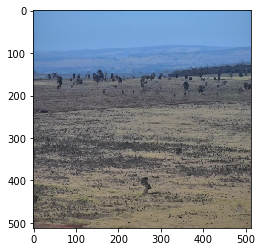

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


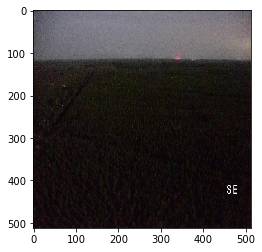

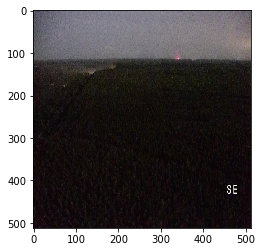

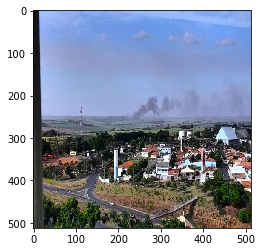

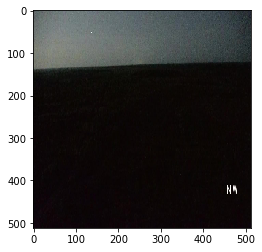

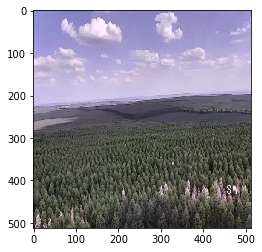

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


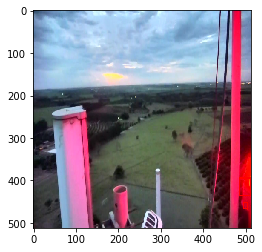

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


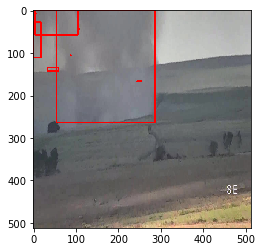

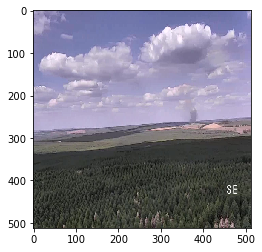

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


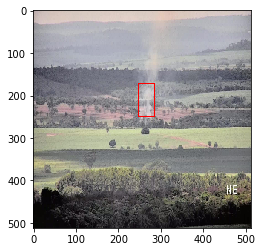

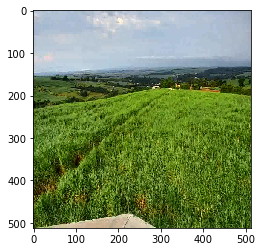

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


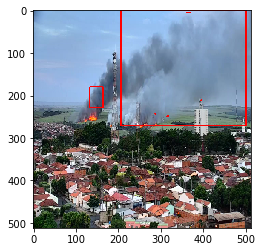

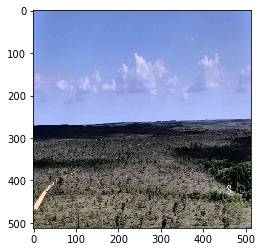

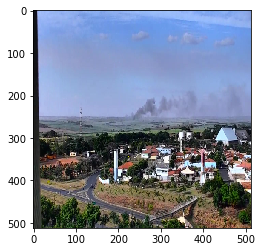

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


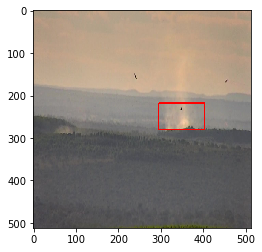

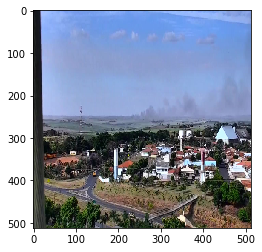

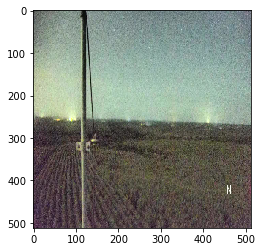

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


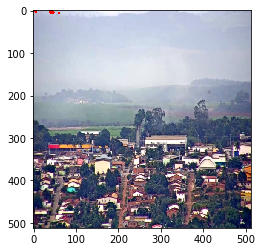

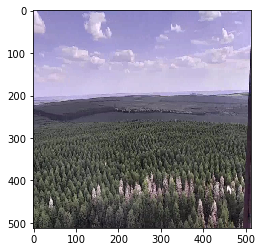

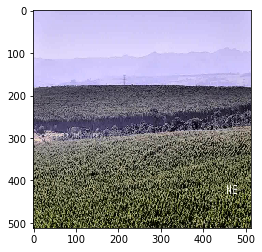

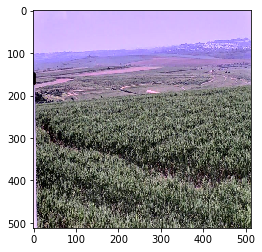

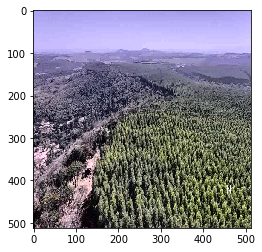

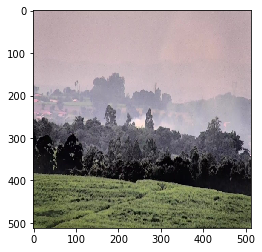

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


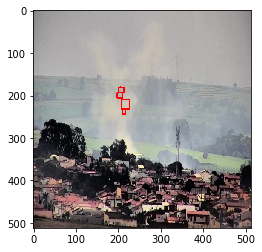

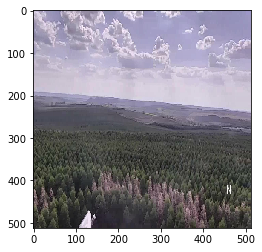

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


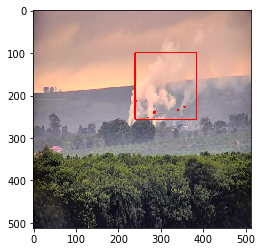

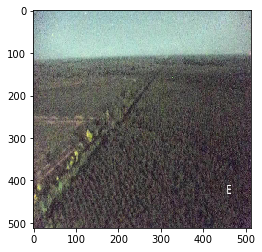

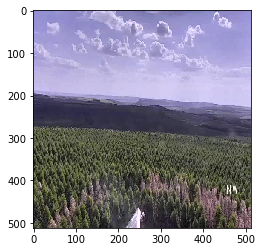

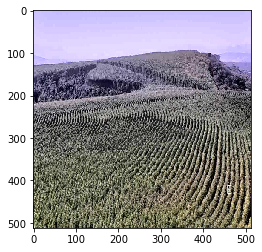

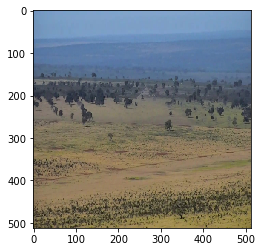

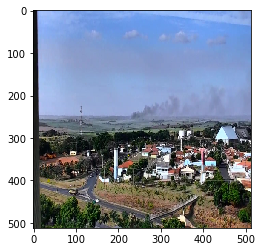

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


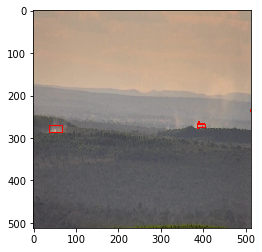

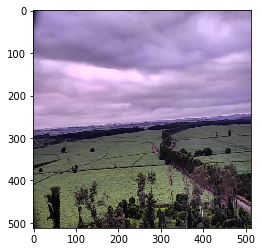

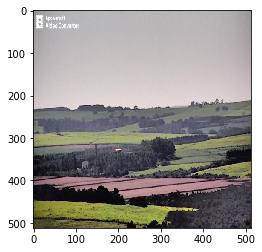

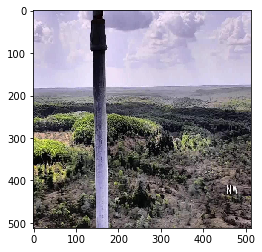

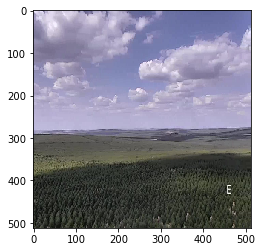

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


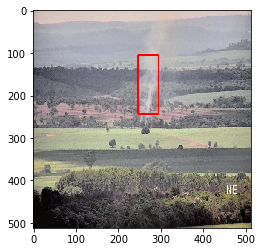

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


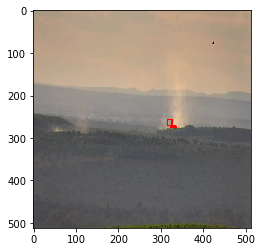

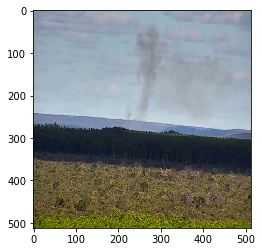

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


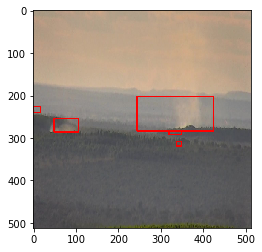

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


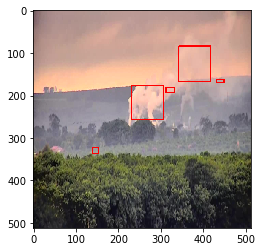

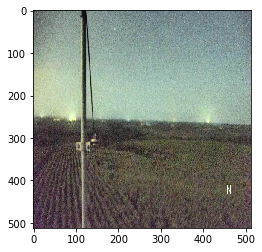

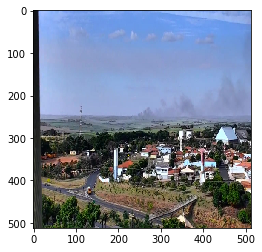

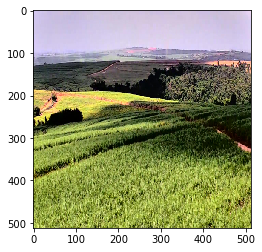

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


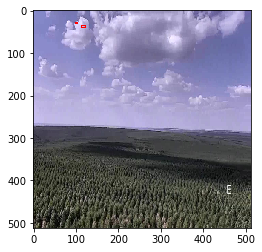

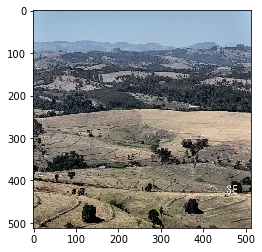

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


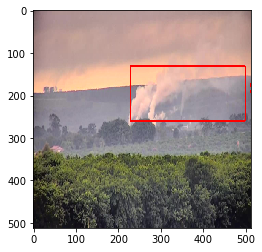

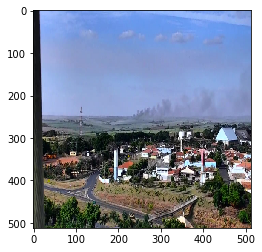

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


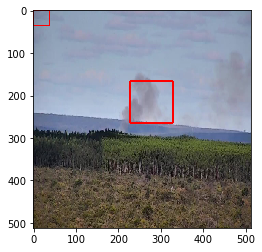

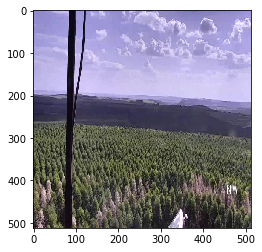

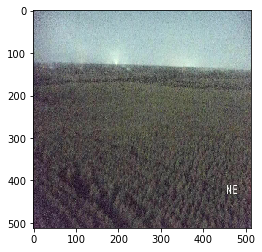

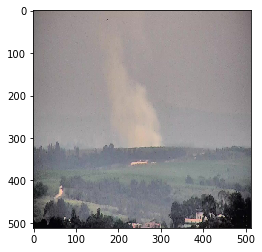

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


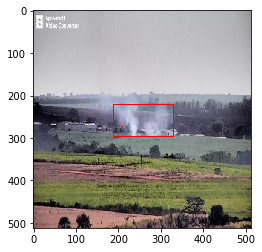

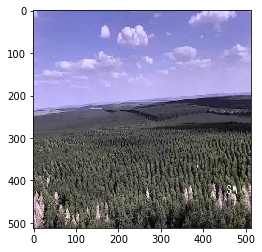

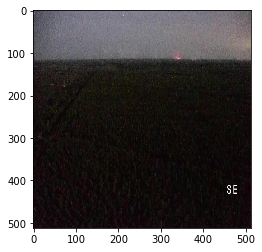

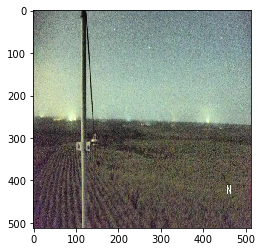

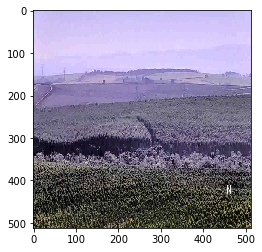

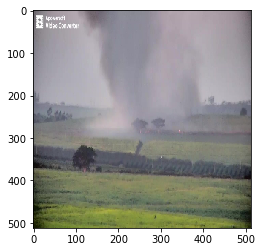

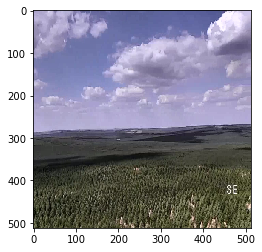

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


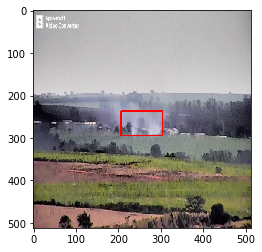

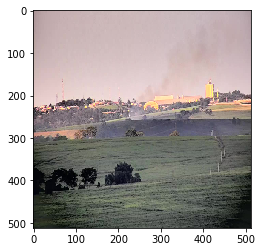

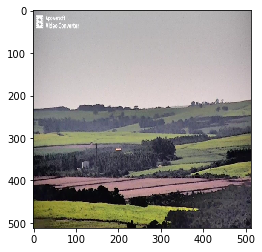

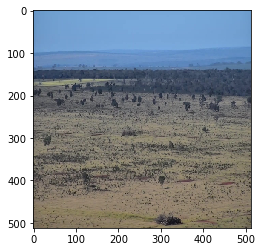

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


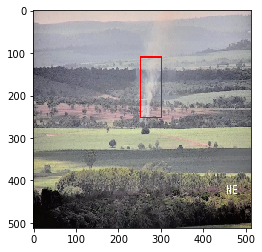

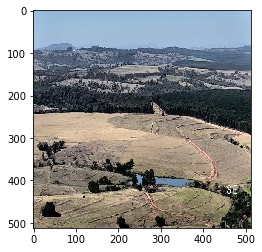

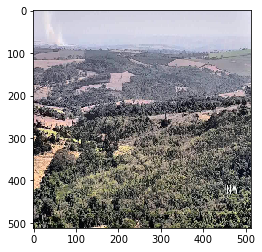

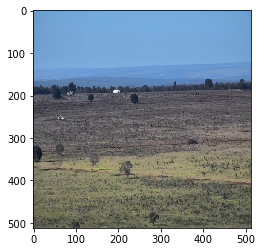

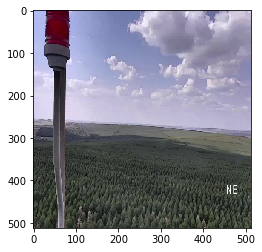

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


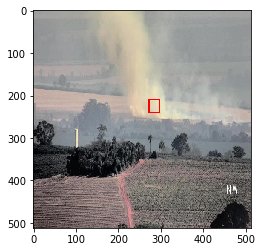

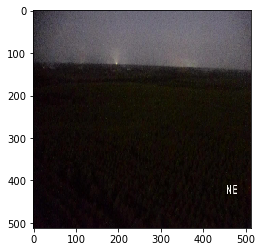

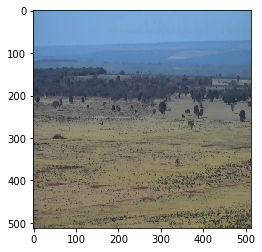

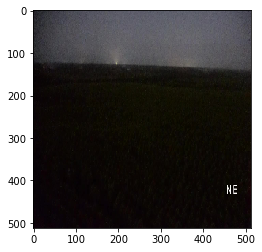

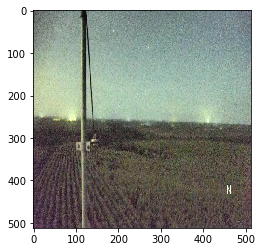

...

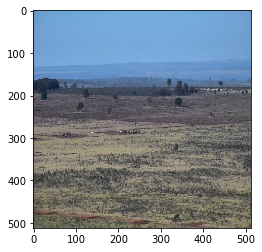

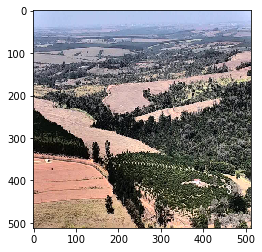

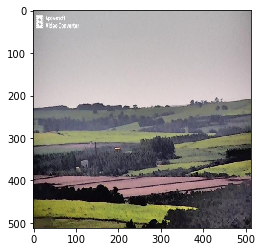

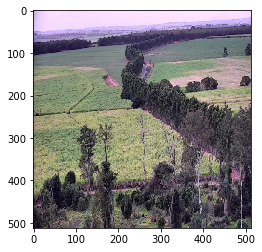

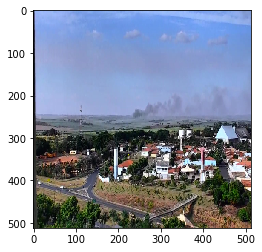

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


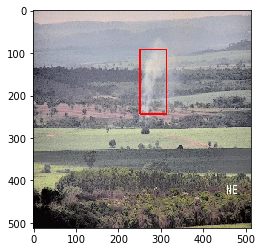

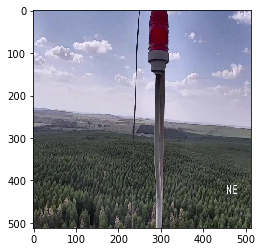

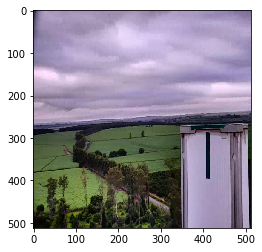

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


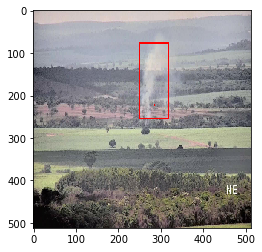

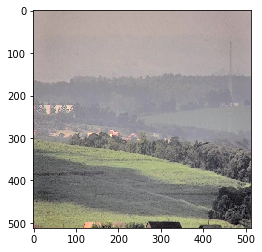

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


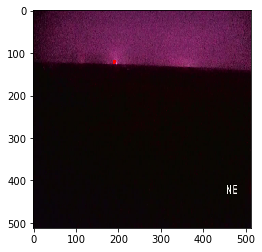

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


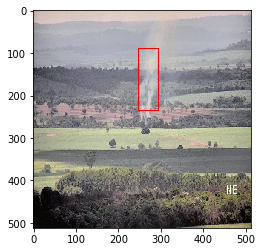

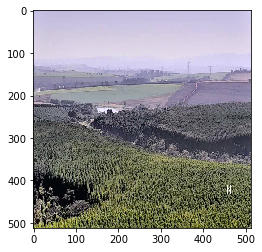

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


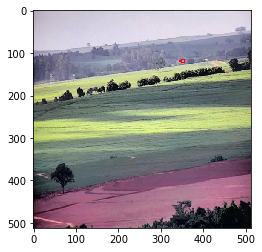

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


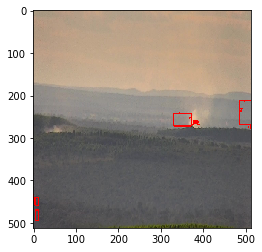

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


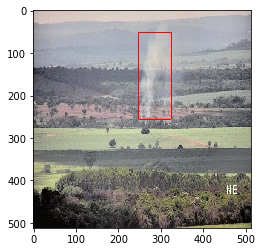

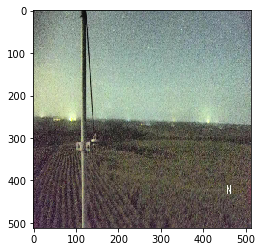

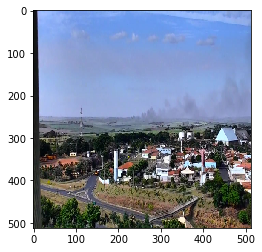

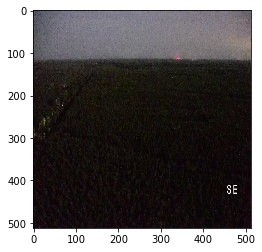

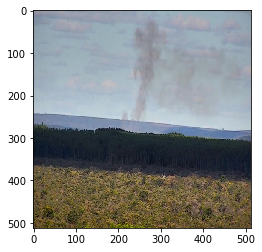

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


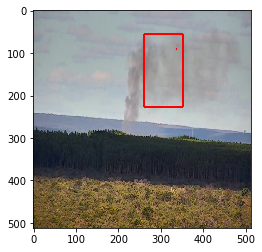

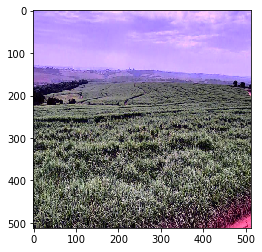

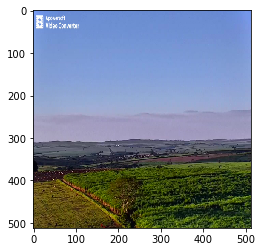

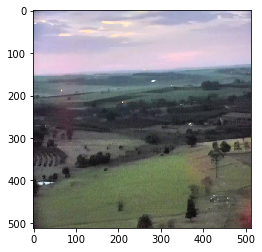

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


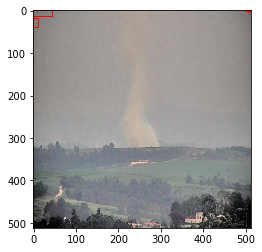

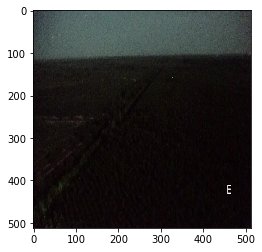

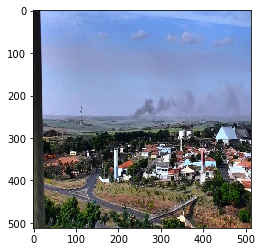

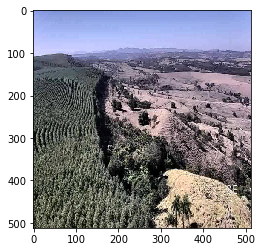

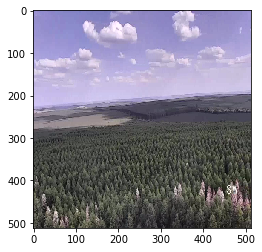

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


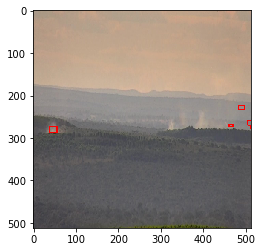

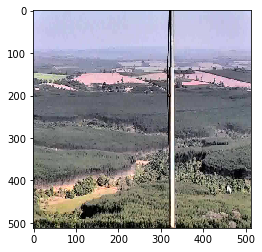

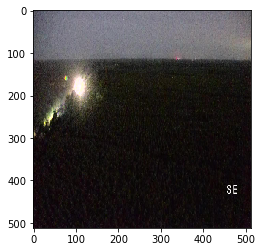

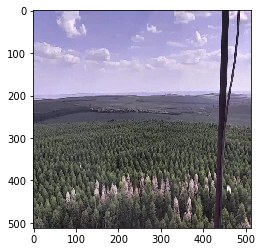

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


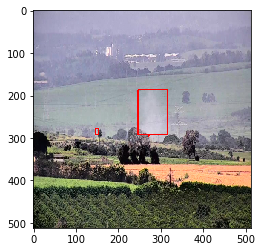

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


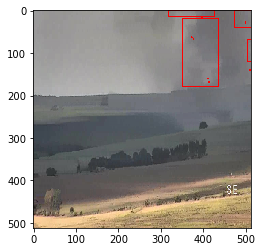

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


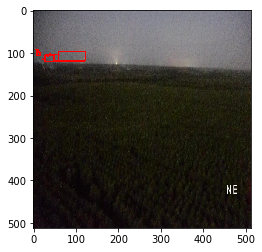

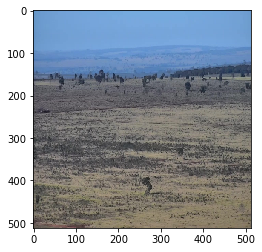

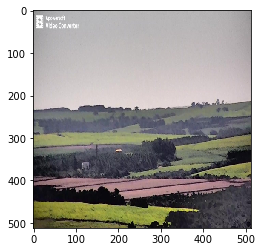

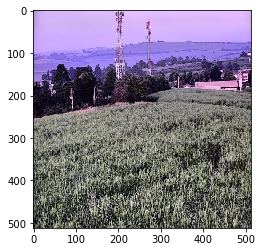

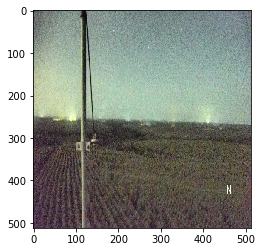

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


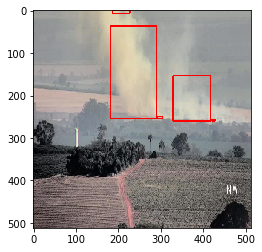

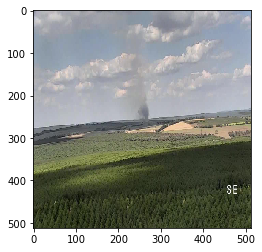

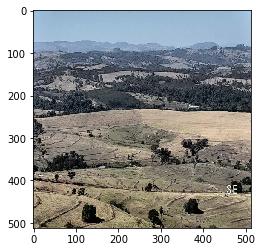

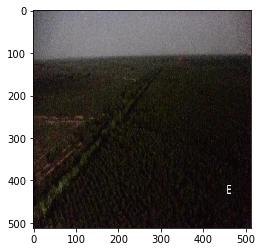

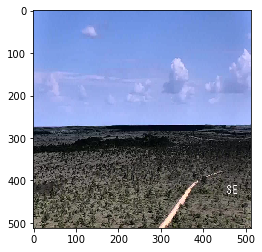

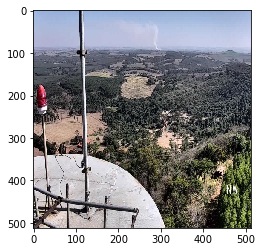

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


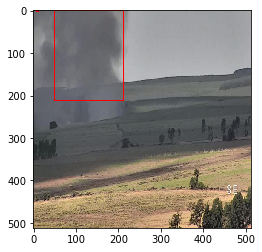

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


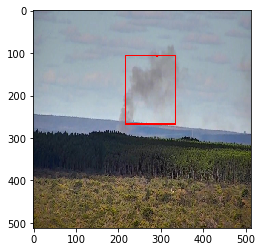

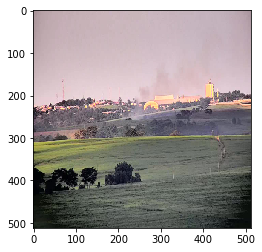

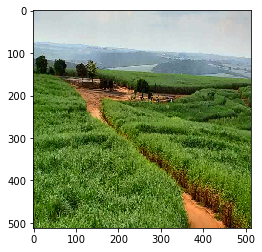

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


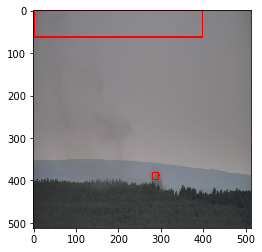

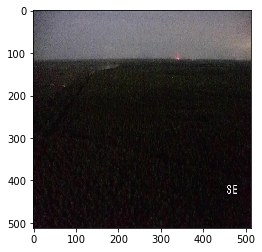

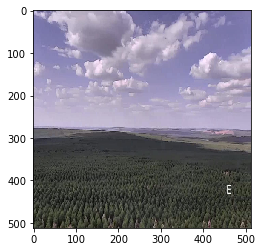

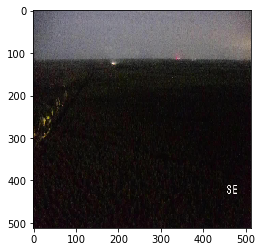

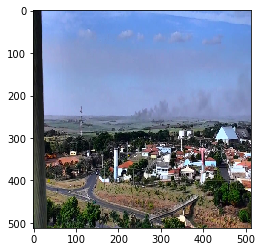

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


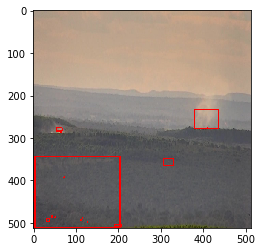

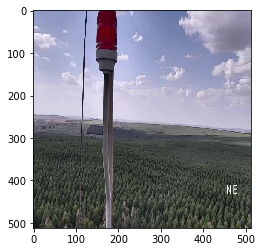

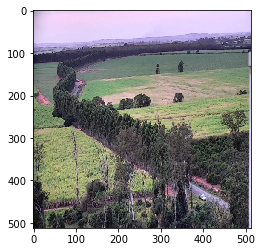

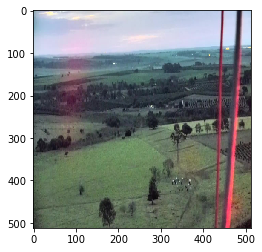

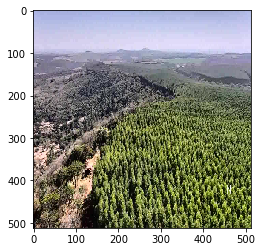

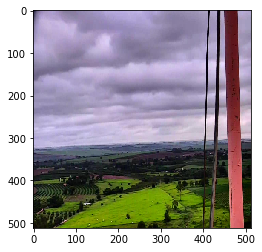

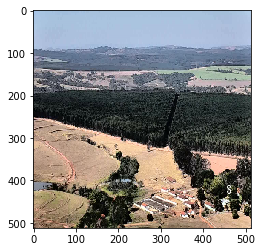

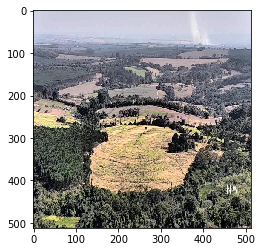

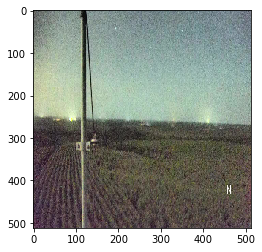

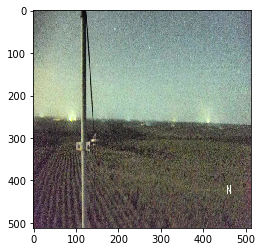

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


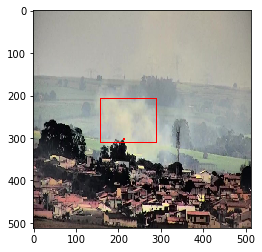

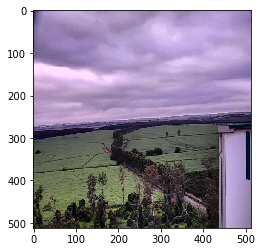

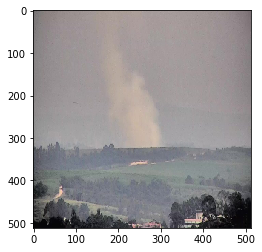

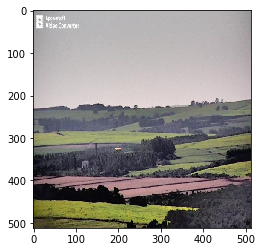

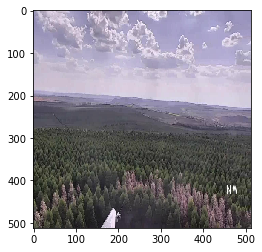

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


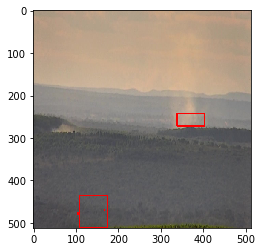

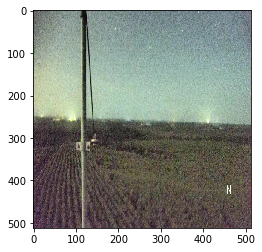

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


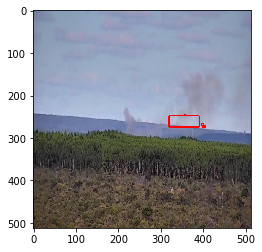

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


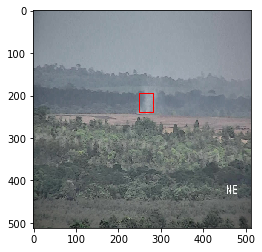

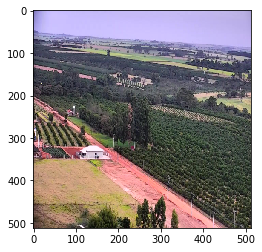

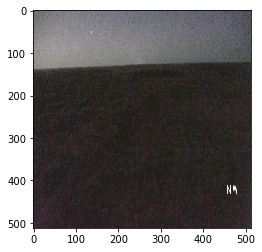

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


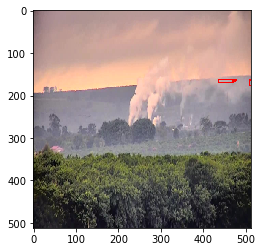

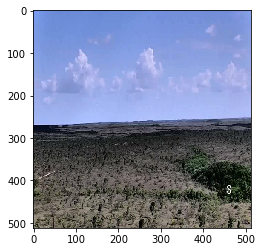

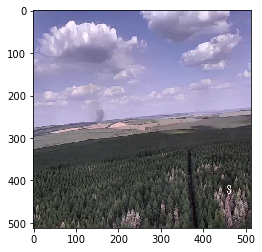

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


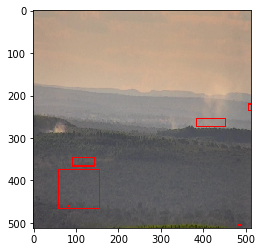

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


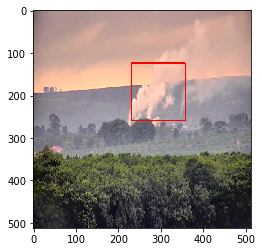

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


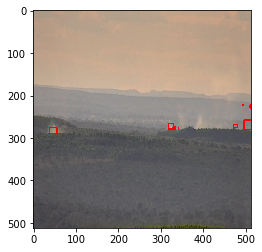

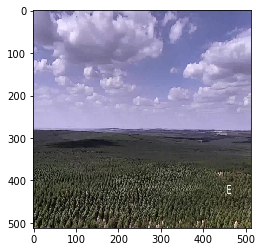

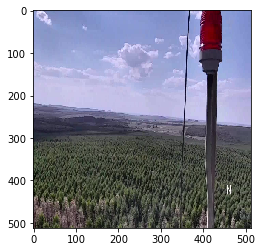

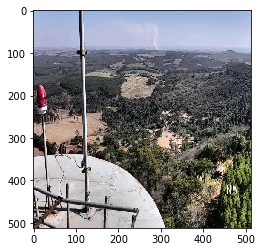

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


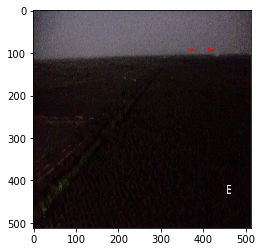

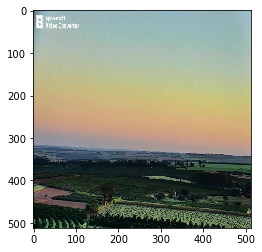

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


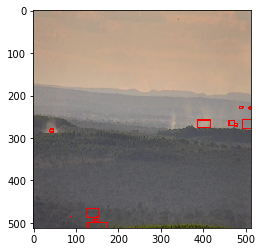

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


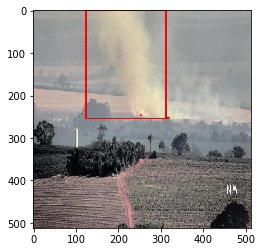

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


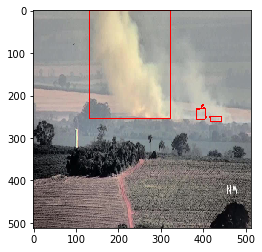

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


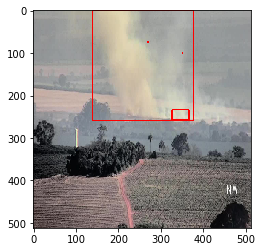

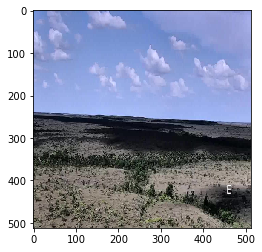

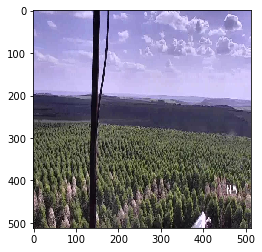

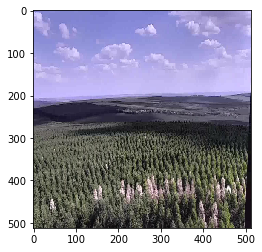

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


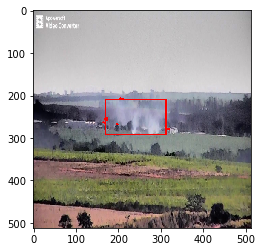

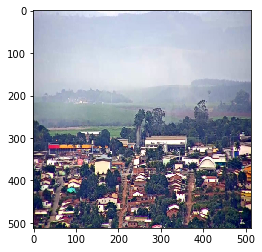

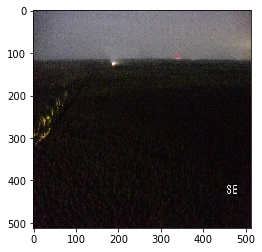

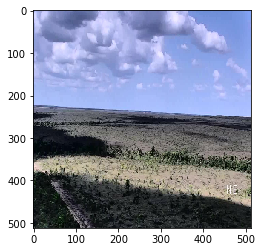

In [32]:
omdena_test_images='data/Smoke_segmentation/omdena_Test'

    
test_names=get_image_files(omdena_test_images)


predicted_masks=[]

for i in range(len(test_names)):
    
    img = open_image(test_names[i])
    predicted_mask=learn.predict(img)
    mask = predicted_mask[0].data.numpy().transpose((1, -1, 0))
    lbl_0 = label(mask)
    props = regionprops(lbl_0)
    img_0=cv2.resize(img.data.numpy().transpose((1, -1, 0)), (512, 512)).reshape(mask.shape[0], mask.shape[1],3)
    img_1 = img_0.copy()
    for prop in props:
        cv2.rectangle(img_1, (prop.bbox[1], prop.bbox[0]), (prop.bbox[4], prop.bbox[3]),(255, 0, 0), 2)
    plt.imshow(img_1)

    plt.show()